# Text to Text Explanation

In [2]:
%load_ext autoreload 
%autoreload 2

In [3]:
from rdkit import Chem
import re

In [4]:
import numpy as np
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM
import shap
import torch

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

In [5]:
from EFGs import mol2frag

In [6]:
from matplotlib import cm

In [7]:
def map_atom2stridx(smiles):
    pattern = "[=#]?(\[[^\]]+\]|Br?|Cl?|N|O|S|P|F|I|b|c|n|o|s|p)[0-9]{0,2}"
    atom_finder = re.compile(pattern)
    ms = [x for x in atom_finder.finditer(smiles)]
    map_dict = {i:(x.start(),x.end()) for i,x in enumerate(ms)}
#     print(map_dict)
    smiles = smiles.replace('>>', '.') if '>>' in smiles else smiles.replace('>', '.')
    assert Chem.MolFromSmiles(smiles).GetNumAtoms() == len(map_dict)
    return map_dict

In [8]:
# import packages
from rdkit import Chem
# from rdkit.Chem.Draw import IPythonConsole
from IPython.display import SVG, Image
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D

def prettymol(smiles, asMol=False, label=None, path='', imgsize=(300, 200), highlights=None):
    '''
    highlights is a dictionary, which may contains:
    highlightAtoms: list
    highlightBonds: list
    highlightAtomRadii: dict[int]=float, atom index (int), radius (float)
    highlightAtomColors: dict[int]=tuple, index (int), color (tuple, length=3)
    highlightBondColors: dict[int]=tuple,index (int), color (tuple, length=3)
    '''
    if asMol:
        mol = smiles.__copy__()
    else:
        mol = Chem.MolFromSmiles(smiles)
    mol = rdMolDraw2D.PrepareMolForDrawing(mol)
    if '.png' in path:
        drawer = rdMolDraw2D.MolDraw2DCairo(*imgsize)
    else:
        drawer = rdMolDraw2D.MolDraw2DSVG(*imgsize)
    opts = drawer.drawOptions()
    if label == 'map':
        for i in range(mol.GetNumAtoms()):
            opts.atomLabels[i] = mol.GetAtomWithIdx(
                i).GetSymbol()+str(mol.GetAtomWithIdx(i).GetAtomMapNum())
    elif label == 'idx':
        for i in range(mol.GetNumAtoms()):
            opts.atomLabels[i] = mol.GetAtomWithIdx(i).GetSymbol()+str(i)
    else:
        _ = [a.ClearProp('molAtomMapNumber') for a in mol.GetAtoms()]
    if not highlights:
        drawer.DrawMolecule(mol)
    else:
        drawer.DrawMolecule(mol, **highlights)
    drawer.FinishDrawing()
    if '.png' in path:
        drawer.WriteDrawingText(path)
        display(Image(path))
    else:
        svg = drawer.GetDrawingText()
        display(SVG(svg.replace('svg:','')))
        if '.svg' in path:
            with open(path, 'w') as wf:
                print(svg, file=wf)
    return drawer

## Forward reaction prediction and single-step retrosynthesis

In [9]:
from IPython.core.debugger import set_trace

In [10]:
from functools import partial

In [11]:
from transformers import T5Config, T5ForConditionalGeneration                   
                                                                                
from data import T5MolTokenizer, T5SelfiesTokenizer, T5SimpleTokenizer, TaskPrefixDataset, data_collator
from models import T5ForSoftLabel

In [256]:
# load the model and tokenizer
# tokenizer = T5SimpleTokenizer(vocab_file='../models/USPTO_TPL/bidirectional/vocab.pt', max_size=100)
# model = T5ForConditionalGeneration.from_pretrained("../models/USPTO_TPL/bidirectional/")#.cuda()
tokenizer = T5SimpleTokenizer(vocab_file='../models/USPTO_MT_X5/mixed/vocab.pt', max_size=100)
model = T5ForConditionalGeneration.from_pretrained("../models/USPTO_MT_X5/mixed/")#.cuda()
# model = T5ForSoftLabel.from_pretrained('../models/USPTO_TPL/Classification/') 
model.config.task_specific_params = {}
model.config.task_specific_params["text-generation"] = {                                                             
          "early_stopping": True,                                                 
          "max_length": 70,                                 
#           "num_beams": 10,                                            
#           "num_return_sequences": 1,                                 
          "decoder_start_token_id": tokenizer.pad_token_id,                       
#           "repetition_penalty": 0,                                 
        }
# define the input sentences we want to translate
data = [
#     CO.O=C(O)CCc1ccc(O)cc1>O=C([O-])O.O=S(=O)(O)O.[Na+]>COC(=O)CCc1ccc(O)cc1
#     COCCOc1ccc([N+](=O)[O-])cc1Cl>CCO.CCOC(C)=O.[Pt]>COCCOc1ccc(N)cc1Cl
#     "Product:CO.CSc1ccc([N+](=O)[O-])c(C(=O)O)c1.[H][H].[Ni]>>",
    "Product:COCCOc1ccc([N+](=O)[O-])cc1Cl.CCO.CCOC(C)=O.[H][H].[Pt]>>",
    #"CSc1ccc(N)c(C(=O)O)c1",
#     "Product:CI.CN(C)C=O.COc1ccc(Cn2c(=O)cc(C(F)(F)F)[nH]c2=O)cc1.Cl.O=C([O-])[O-].[K+].[K+]>>",
    #"COc1ccc(Cn2c(=O)cc(C(F)(F)F)n(C)c2=O)cc1"
    "Reactants:COCCOc1ccc(N)cc1Cl",
    # CSc1ccc([N+](=O)[O-])c(C(=O)O)c1
    "Reagents:COCCOc1ccc([N+](=O)[O-])cc1Cl>>COCCOc1ccc(N)cc1Cl",
    "Classification:COCCOc1ccc([N+](=O)[O-])cc1Cl>CCO.CCOC(C)=O.[Pt]>COCCOc1ccc(N)cc1Cl"
    # CC(C)(C)[Si](C)(C)OC[C@@H]1CN2CCC[C@H]2C(=O)N1.CI
]

### Explain the model's predictions

In [257]:
# we build an explainer by passing the model we want to explain and
# the tokenizer we want to use to break up the input strings
# wrapped_model = shap.models.TopKLM(model, tokenizer, k=100)
# set_trace()
explainer = shap.Explainer(model,tokenizer)
# explainers are callable, just like models
# masker = shap.maskers.Text(tokenizer, mask_token = "<mask>", collapse_mask_token=True)
# explainer = shap.Explainer(wrapped_model,masker)
shap_values = explainer(data)

In [302]:
example_id = 2

In [303]:
inputs = tokenizer(data[example_id], return_tensors='pt')
outputs = model.generate(**inputs, max_length=70)
tokenizer.decode(outputs[0])
# COCCOc1ccc([N+](=O)[O-])cc1Cl>CCO.CCOC(C)=O.[Pt]>COCCOc1ccc(N)cc1Cl

'<pad>CCO.Cl.O.[Fe]<pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad>'

In [304]:
shap_values[2].shape

(50, 68)

In [305]:
len(shap_values[0].data)

58

In [306]:
Chem.CanonSmiles('COC(=O)c1cc(SC)ccc1N')

'COC(=O)c1cc(SC)ccc1N'

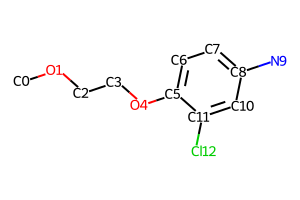

In [307]:
prettymol('COCCOc1ccc(N)cc1Cl', label='idx')

In [308]:
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])

In [309]:
map_dict = map_atom2stridx(tokens)

In [310]:
tokens = tokens.replace('>>', '.').replace('>', '.')

In [311]:
mol = Chem.MolFromSmiles(tokens)
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)

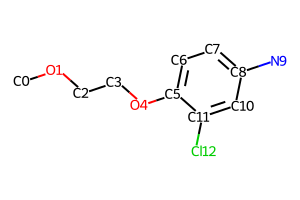

In [289]:
prettymol("COCCOc1ccc(N)cc1Cl", label='idx')

In [290]:
prod_dict = {0:"COCCOc1ccc(N)cc1Cl", 
             1:"COCCOc1ccc([N+](=O)[O-])cc1Cl", 
             2:"CCO.Cl.O.[Fe]", 
             3:"CC(C)(C)[Si](C)(C)OC[C@@H]1CN2CCC[C@H]2C(=O)N1.CI"}
react_idx = {0:(9,), 1:(9,10,11), 
             2:(0,1,2,3,4,5), 3:(18,19,20)}
map_dict_target = map_atom2stridx(prod_dict[example_id])
selected_index = []
for idx in react_idx[example_id]:
    selected_index += list(range(map_dict_target[idx][0], map_dict_target[idx][1]))
selected_index, prod_dict[example_id][min(selected_index):max(selected_index)+1]

([11, 12, 13, 14, 16, 17, 19, 20, 21, 22], '[N+](=O)[O-]')

In [291]:
class colorscaler(object):
    def __init__(self,array):
        self.max = int(max(array)*400)
        
    def convert(self, value):
        return int(self.max/2+value*100)

In [292]:
def token2fg(fgids, map_dict):
    from itertools import chain
    fg_dict = {}
    for i,fg in enumerate(fgids):
        for a in fg:
            fg_dict[i] = list(chain(fg_dict.get(i,[]), range(map_dict[a][0],map_dict[a][1])))
    fg_dict_reverse = {val:key for key,values in fg_dict.items() for val in values}
    for i in range(len(tokens)):
        if not i in fg_dict_reverse:
            if i-1 in fg_dict_reverse and i+1 in fg_dict_reverse:
                if tokens[i] in ('.', '>'):
                    continue
                elif tokens[i] == '(':
                    fg_dict_reverse[i] = fg_dict_reverse[i+1]
                else:
                    fg_dict_reverse[i] = fg_dict_reverse[i-1]
    for i,j in fg_dict_reverse.items():
        if i in fg_dict[j]: continue
        else:
            fg_dict[j].append(i)
    return fg_dict

In [293]:
shap_values.data

array([list(['Product: ', 'C ', 'O ', 'C ', 'C ', 'O ', 'c ', '1 ', 'c ', 'c ', 'c ', '( ', '[ ', 'N ', '+ ', '] ', '( ', '= ', 'O ', ') ', '[ ', 'O ', '- ', '] ', ') ', 'c ', 'c ', '1 ', 'C ', 'l ', '. ', 'C ', 'C ', 'O ', '. ', 'C ', 'C ', 'O ', 'C ', '( ', 'C ', ') ', '= ', 'O ', '. ', '[ ', 'H ', '] ', '[ ', 'H ', '] ', '. ', '[ ', 'P ', 't ', '] ', '> ', '> ']),
       list(['Reactants: ', 'C ', 'O ', 'C ', 'C ', 'O ', 'c ', '1 ', 'c ', 'c ', 'c ', '( ', 'N ', ') ', 'c ', 'c ', '1 ', 'C ', 'l ']),
       list(['Reagents: ', 'C ', 'O ', 'C ', 'C ', 'O ', 'c ', '1 ', 'c ', 'c ', 'c ', '( ', '[ ', 'N ', '+ ', '] ', '( ', '= ', 'O ', ') ', '[ ', 'O ', '- ', '] ', ') ', 'c ', 'c ', '1 ', 'C ', 'l ', '> ', '> ', 'C ', 'O ', 'C ', 'C ', 'O ', 'c ', '1 ', 'c ', 'c ', 'c ', '( ', 'N ', ') ', 'c ', 'c ', '1 ', 'C ', 'l ']),
       list(['Classification: ', 'C ', 'O ', 'C ', 'C ', 'O ', 'c ', '1 ', 'c ', 'c ', 'c ', '( ', '[ ', 'N ', '+ ', '] ', '( ', '= ', 'O ', ') ', '[ ', 'O ', '- ', '] '

In [294]:
for x, y in zip(shap_values.data[example_id][1:], np.sum(shap_values[example_id].values[1:,range(min(selected_index), max(selected_index)+1)], axis=1)):
    print(x,y)
# range(min(selected_index), max(selected_index)+1)], axis=1)

C  14.513068253833923
O  -0.8343425677726071
C  -0.8343425677726071
C  6.291705901708333
O  6.291705901708333
c  0.9566935629405124
1  0.9566935629405124
c  4.3589982217996
c  4.3589982217996
c  4.3589982217996
(  16.7267976386271
N  15.575724149253194
)  15.575724149253194
c  12.748035643484503
c  11.3021865393624
1  10.84332242533272
C  10.84332242533272
l  10.090205535615313


In [295]:
token_map

{0: [1],
 1: [4],
 2: [16, 17, 11, 12, 13, 14, 19, 20, 21, 22, 10, 15, 18, 23],
 3: [27, 28],
 4: [32],
 5: [41, 42, 37, 36],
 6: [51, 52, 53, 54],
 7: [5, 6, 7, 8, 9, 24, 25, 26],
 8: [0],
 9: [2, 3],
 10: [30, 31],
 11: [34, 35],
 12: [39, 38, 40],
 13: [44, 45, 46],
 14: [47, 48, 49]}

In [253]:
for x,y in zip(fgs+fgs_ch, fg_ids+fg_chids):
    print(x,y)

O (1,)
O (4,)
O=[N+][O-] (10, 9, 11)
Cl (14,)
O (17,)
O=CO (23, 21, 20)
[Pt] (24,)
c1ccccc1 (5, 6, 7, 8, 12, 13)
C010 (0,)
CC (2, 3)
CC (15, 16)
CC (18, 19)
C010 (22,)


In [254]:
fg

(22,)

1 -0.8343425677726071
4 6.291705901708333
12 20.933527960948034
9 47.878245937133485
5 49.88392639945944
6 49.88392639945944
7 49.88392639945944
8 49.88392639945944
10 49.88392639945944
11 49.88392639945944
0 14.513068253833923
2 5.457363333935726
3 5.457363333935726


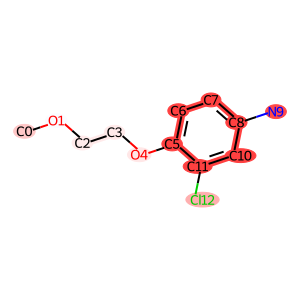

In [301]:
#mol_smi = Chem.MolFromSmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = np.sum(shap_values[example_id].values[1:,range(min(selected_index), max(selected_index)+1)], axis=1)
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
# for a in color_atoms:
#     val = sum(shap_tokens[map_dict[a][0]:map_dict[a][1]])
#     color_dicts_a[a] = bwr(cs.convert(val))[:3]
token_map = token2fg(fg_ids+fg_chids, map_dict)
for i,fg in enumerate(fg_ids+fg_chids):
    shap_val = shap_tokens[token_map[i]]
    for a in fg:
        print(a,np.sum(shap_val))
        color_dicts_a[a] = bwr(cs.convert(np.sum(shap_val)/2))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(300,300), label='idx')
#,'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b

In [300]:
for i in range(len(color_dicts_a)):
    print(i,np.array(color_dicts_a[i])*255)

0 [255.         218.13574525 218.13574525 255.        ]
1 [252.90327403 252.90327403 255.         255.        ]
2 [255.         241.16160861 241.16160861 255.        ]
3 [255.         241.16160861 241.16160861 255.        ]
4 [255.         239.02676035 239.02676035 255.        ]
5 [255.         128.24338466 128.24338466 255.        ]
6 [255.         128.24338466 128.24338466 255.        ]
7 [255.         128.24338466 128.24338466 255.        ]
8 [255.         128.24338466 128.24338466 255.        ]
9 [255.         133.35177157 133.35177157 255.        ]
10 [255.         128.24338466 128.24338466 255.        ]
11 [255.         128.24338466 128.24338466 255.        ]
12 [255.         201.81940499 201.81940499 255.        ]


### Visualize shap explanations

In [159]:
# "CSc1ccc(N)c(C(=O)O)c1",
# "FC(F)(F)c1cccnc1N1CCNCC1"
# CC(C)(C)OC(=O)OC(=O)OC(C)(C)C.NCC1CCNCC1
# Cc1c(I)ccc(F)c1CO.O=S(Cl)Cl

In [223]:
shap.plots.text(shap_values)#, group_threshold=10e-5)

,Product: C O C,C O c 1,c c c,( [ N + ] ( = O ),[ O - ] ),c c 1 C l,.,C C O . C C O C ( C ) = O .,[ P t ],> >
C,-1.526,0.638,1.347,1.848,-0.174,1.57,0.561,2.256,0.451,-0.692
O,19.27,0.826,1.859,1.864,-0.669,1.644,0.557,1.468,1.653,0.071
C,11.382,1.301,0.935,1.166,-0.105,0.179,0.253,1.06,0.045,0.369
C,0.95,8.207,0.647,-0.064,-0.003,0.197,0.16,1.345,-0.395,-0.209
O,8.786,8.758,1.066,2.102,-0.098,0.111,0.333,2.803,3.531,1.939
c,6.474,5.263,2.967,3.845,-0.33,0.119,0.52,1.901,2.056,1.881
1,8.224,2.126,2.198,1.836,0.187,0.001,-0.049,0.104,1.645,1.267
c,9.117,0.605,3.569,1.876,-0.65,0.366,0.174,1.218,2.647,2.741
c,4.462,-1.292,2.631,0.146,-1.625,-0.254,0.307,1.16,2.049,2.016
c,6.816,2.587,1.704,-0.222,-0.436,1.118,0.305,1.933,1.967,1.401


,Reactants:,C,O C,C O,c 1,c c c,(,N ),c,c,1 C l
C,-1.988,1.051,-0.731,0.589,0.158,1.578,0.106,0.184,0.145,0.118,-0.827
O,7.558,3.328,3.802,1.114,0.886,0.882,-0.09,-0.356,1.114,0.978,1.651
C,-0.229,2.143,5.087,2.637,0.943,2.545,0.126,-0.376,0.109,-0.096,-1.061
C,-2.312,0.878,5.34,6.051,0.374,2.059,-0.22,-0.607,-0.4,-0.5,-2.24
O,6.883,0.075,0.56,7.997,1.114,-0.765,0.72,0.963,0.528,0.317,0.334
c,5.945,-0.565,1.421,3.066,2.543,4.244,0.718,0.573,-0.583,-0.714,-1.512
1,7.996,0.874,-0.127,0.996,0.752,4.612,0.858,1.295,0.65,0.69,2.491
c,5.961,0.979,-1.526,-0.354,1.215,6.685,1.143,2.22,1.348,1.121,2.196
c,0.942,2.1,-1.614,-1.505,-1.321,3.181,0.102,0.555,1.721,0.849,0.186
c,2.55,0.748,-1.715,1.09,1.477,2.796,0.325,0.483,1.389,1.347,2.354


,Reagents: C,O C,C O c 1 c c c,( [ N + ],( = O ),[ O,- ] ),c c 1 C l > > C,O C C O,c 1 c c c ( N ),c c 1 C l
C,-0.949,-0.086,1.415,0.83,0.478,-0.231,-0.262,-0.502,1.18,-0.862,-1.189
C,-1.04,-0.536,1.199,0.68,0.45,-0.521,-0.721,-1.182,0.187,0.617,-0.973
O,3.137,2.107,-0.118,0.409,-0.271,-0.147,0.457,0.939,4.258,0.467,0.782
.,3.001,1.551,4.542,1.72,1.848,-0.775,-0.891,0.947,-0.436,3.833,1.548
C,-0.921,-0.396,-0.342,0.361,0.123,0.054,-0.167,-0.933,0.779,-0.858,-0.395
l,3.053,1.589,0.823,0.033,-0.062,0.485,0.335,2.202,-0.952,2.536,0.588
.,2.658,1.492,3.818,1.69,1.195,-0.624,-0.576,1.566,0.949,3.513,1.792
O,4.121,2.189,2.016,0.803,0.392,-0.089,0.162,-0.106,3.998,1.526,1.32
.,3.083,1.782,3.815,2.066,1.411,-0.724,-0.846,2.721,0.364,3.949,3.266
[,3.887,2.308,1.134,0.813,0.513,-0.463,-0.341,0.396,0.98,-0.412,2.857


,Classification: C O C,C O c 1 c c c,( [ N + ] ( = O ) [ O - ] ),c c,1 C,l > C C O,.,C C O C ( C ) = O .,[ P t ],> C O C,C O c 1 c c c ( N ),c c 1 C l
C,-0.68,-0.456,1.445,0.632,0.142,0.379,-0.341,1.279,-0.267,-1.734,-1.729,-0.395
O,5.051,4.665,4.263,-0.403,-0.513,0.233,-0.326,0.184,-0.765,1.544,1.6,0.622
C,0.583,1.542,2.127,-0.603,-0.633,0.611,0.661,0.377,0.942,-0.092,-1.221,-0.423
C,0.854,1.079,-0.489,-0.686,-0.573,0.264,0.823,-0.306,1.154,0.898,-0.17,-0.217
O,5.933,5.321,0.578,-0.607,0.106,0.324,0.76,0.793,0.834,3.837,3.023,0.813
c,2.677,3.429,-1.666,-0.349,0.148,-0.838,1.178,-0.132,1.235,5.216,2.516,-0.15
1,4.443,3.066,3.112,0.023,-0.023,0.206,0.018,0.11,0.551,2.197,3.215,1.085
c,4.581,3.148,2.68,0.051,-0.221,-0.185,0.1,0.977,-0.156,1.663,2.533,0.679
c,2.891,1.201,3.397,0.299,-0.992,-0.075,-0.284,0.173,0.306,-1.592,-0.328,-0.135
c,2.529,0.63,1.292,0.2,-0.658,-0.597,0.143,0.345,0.59,1.701,0.7,0.286


## Reaction Type Classification

In [51]:
data = [
    "Classification:CO.CSc1ccc([N+](=O)[O-])c(C(=O)O)c1.[H][H].[Ni]>>CSc1ccc(N)c(C(=O)O)c1",
    "Classification:CCCCSc1cc(C(=O)O)cc(S(N)(=O)=O)c1Cc1ccccc1.CCO.CO.NS(=O)(=O)c1cc(C(=O)O)cc(SCc2ccccc2)c1Cc1ccccc1>>CCOC(=O)c1cc(SCc2ccccc2)c(Cc2ccccc2)c(S(N)(=O)=O)c1",
    "Classification:CCCOc1ccc(C(=O)C(=O)N(CC(=O)OCC)CC(=O)OCC)cc1.CO.[Na+].[OH-]>>CCCOc1ccc(C(=O)C(=O)N(CC(=O)O)CC(=O)O)cc1",
]

In [52]:
tokenizer = T5SimpleTokenizer(vocab_file='../models/USPTO_TPL/Classification/vocab.pt', max_size=100)
model = T5ForSoftLabel.from_pretrained("../models/USPTO_TPL/Classification/")#.cuda()

In [53]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

A warpper would be needed to pass through explainer object:

In [54]:
def classifier(x):
#     set_trace()
    tv = tokenizer.batch_encode_plus(x,return_tensors='pt',truncation=True,padding="longest")
#     attention_mask = (tv!=0).type(torch.int64)
    for k, v in tv.items():                                              
        if isinstance(v, torch.Tensor):                                     
            tv[k] = v.to(device)
    outputs = model(**tv).logits.detach().cpu().numpy()
#     scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
#     val = sp.special.logit(scores) 
    return outputs

In [55]:
classifier(data).shape

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


(3, 1000)

In [56]:
explainer = shap.Explainer(classifier,tokenizer,output_names=[str(i) for i in range(1000)])
shap_values = explainer(data)

In [57]:
# set_trace()
shap_values = explainer(data)

In [58]:
labels = np.argmax(classifier(data),1)
# 366, 47, 255

In [59]:
labels

array([  1,  47, 255])

In [127]:
shap.plots.text(shap_values[0])#, group_threshold=1)

,Classification: C O .,C S c 1 c c c ( [ N + ] ( = O ),[ O - ] ),c ( C ( = O ),O ),c 1 .,[ H ] [ H ] .,[ N i ] > > C S,c 1 c c c ( N ) c,( C ( = O ) O ) c 1
0,1.626,1.37,-0.825,-2.063,-0.83,0.075,-0.43,0.354,-1.515,2.952
1,-0.413,13.67,5.254,4.307,0.58,0.521,2.248,4.008,8.182,-0.8
2,-0.934,4.98,1.828,-2.634,-0.84,0.812,0.514,-0.867,-3.187,2.73
3,-1.104,-5.707,-2.016,-0.948,-1.622,1.353,2.511,-0.369,-0.84,1.108
4,-1.337,-1.941,0.097,1.857,-0.271,0.054,0.444,1.073,0.796,0.149
5,0.815,-5.509,-1.994,0.119,-0.239,1.474,2.246,-0.359,1.193,0.06
6,-0.291,1.215,-0.421,2.57,1.57,-0.488,-0.142,1.969,5.477,-1.487
7,-0.135,-3.246,0.063,0.252,0.145,0.429,1.348,-0.463,1.624,-0.623
8,-0.158,-5.995,-1.41,-1.429,0.148,0.644,-0.226,-0.171,0.249,0.205
9,0.36,1.645,-0.524,0.456,-0.398,1.219,1.172,0.901,5.33,-2.462


We found that label 366 should be the most intense prediction, here we want to visualize the shap value: first I will map atom idx (from rdkit) to corresponding SMILES string position index; Then I will color every atom based on  their shap values (I would do some transformations since the color range has to be between 0-1.)

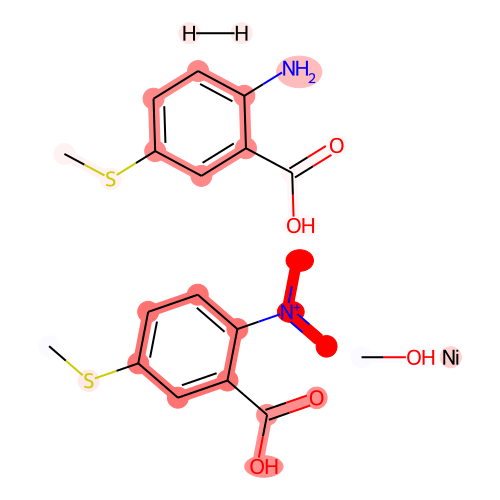

In [60]:
example_id = 0
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])
map_dict = map_atom2stridx(tokens)
mol = Chem.MolFromSmiles(tokens.replace('>>', '.'))
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)
#mol_smi = Chem.MolFromSCCO.O=C(NOCCO)c1ccc(F)c(F)c1Nc1ccc(C#CCO)cc1F.[Pd]>>O=C(NOCCO)c1ccc(F)c(F)c1Nc1ccc(CCCO)cc1Fmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = shap_values[example_id].values[:,labels[example_id]]
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
token_map = token2fg(fg_ids+fg_chids, map_dict)
for i,fg in enumerate(fg_ids+fg_chids):
    shap_val = shap_tokens[token_map[i]]
    for a in fg:
        color_dicts_a[a] = bwr(cs.convert(np.sum(shap_val)/5))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(500,500))#, label='idx')

In [316]:
token2fg(fg_ids+fg_chids, map_dict)

{0: [1],
 1: [4],
 2: [16, 17, 11, 12, 13, 14, 19, 20, 21, 22, 10, 15, 18, 23],
 3: [28, 29, 26, 31, 25, 27, 30, 32],
 4: [43, 44, 45, 46],
 5: [50],
 6: [57, 56, 58],
 7: [63, 64, 61, 66, 60, 62, 65, 67],
 8: [5, 6, 7, 8, 9, 24, 33, 34],
 9: [51, 52, 53, 54, 55, 59, 68, 69],
 10: [0],
 11: [3],
 12: [36, 37, 38],
 13: [39, 40, 41],
 14: [49]}

## Reaction Yield Prediction

In [61]:
data = [
    "Yield:CCCC[C@H]1CCC(O)C1.Cc1ccc(S(=O)(=O)Cl)cc1.c1ccncc1>>CCCC[C@H]1CCC(OS(=O)(=O)c2ccc(C)cc2)C1", # 97
    "Yield:CN(C)CCCN.Cc1[nH]c2c(c1C(=O)O)CCCC2=O>>Cc1[nH]c2c(c1C(=O)NCCCN(C)C)CCCC2=O", # 83
    "Yield:CCc1cc(-c2ccc(S(=O)(=O)Cl)s2)c(C)[nH]c1=O.OCC1CCCNC1>>CCc1cc(-c2ccc(S(=O)(=O)N3CCCC(CO)C3)s2)c(C)[nH]c1=O", # 6
]

In [62]:
data = [
    "Yield:Ic1cccnc1.Cc1ccc(N)cc1>CN1CCCN2CCCN=C12.COc1ccc(OC)c([P+](C(C)(C)C)(C(C)(C)C)[Pd-2]2(OS(=O)(=O)C(F)(F)F)[NH2+]c3ccccc3-c3ccccc32)c1-c1c(C(C)C)cc(C(C)C)cc1C(C)C.CS(C)=O.c1ccc(-c2ccno2)cc1>Cc1ccc(Nc2cccnc2)cc1", # 92.96
    "Yield:Ic1cccnc1.Cc1ccc(N)cc1>CCN=P(N=P(N(C)C)(N(C)C)N(C)C)(N(C)C)N(C)C.COc1ccc(OC)c([P+](C(C)(C)C)(C(C)(C)C)[Pd-2]2(OS(=O)(=O)C(F)(F)F)[NH2+]c3ccccc3-c3ccccc32)c1-c1c(C(C)C)cc(C(C)C)cc1C(C)C.CS(C)=O.c1ccc(-c2ccno2)cc1>Cc1ccc(Nc2cccnc2)cc1", # 15.13
]

In [63]:
tokenizer = T5SimpleTokenizer(vocab_file='../models/temp_MFF2/vocab.pt', max_size=100)
model = T5ForSoftLabel.from_pretrained("../models/temp_MFF2/", loss_type='KLD')#.cuda()

In [64]:
def rxn_yield(x):
#     set_trace()
    tv = tokenizer.batch_encode_plus(x,return_tensors='pt',truncation=True,padding="longest")
#     attention_mask = (tv!=0).type(torch.int64)
    for k, v in tv.items():                                              
        if isinstance(v, torch.Tensor):                                     
            tv[k] = v.to(device)
    outputs = model(**tv).logits.detach().cpu().numpy()
#     scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
#     val = sp.special.logit(scores) 
    return outputs

In [65]:
labels = torch.softmax(torch.tensor(rxn_yield(data)), dim=1)
# 0.95

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


In [66]:
labels

tensor([[0.0429, 0.9571],
        [0.8755, 0.1245]])

In [67]:
explainer = shap.Explainer(classifier,tokenizer,output_names=['0', '1'])
shap_values = explainer(data)
shap.plots.text(shap_values)

,Yield: I c 1 c c c n c 1 .,C c 1 c c c ( N ) c c 1 > C N 1 C,C C N 2 C C C N,= C 1 2 .,C O c 1 c c c ( O C ) c,( [ P + ] ( C ( C ),( C ) C ) ( C ( C ) ( C ) C ) [ P d - 2 ] 2,( O S ( = O ) ( = O ) C ( F ) ( F ) F ) [ N H 2 + ] c 3 c c c c c 3 - c 3 c c c c c 3 2 ),c 1 - c 1 c ( C ( C ) C ) c c ( C ( C ) C ),c c 1 C ( C ) C . C S ( C ) = O .,c 1 c c c ( - c 2 c c n o 2 ),c c 1 > C c 1 c c c ( N c 2 c c c n c 2 ) c c 1
0,-0.398,-0.102,-0.262,-0.31,0.413,-0.026,-0.059,-0.18,-0.157,0.024,-0.938,-0.389
1,0.091,0.06,0.107,0.102,-0.167,0.001,-0.002,0.029,0.02,-0.023,0.266,0.099


,Yield: I c 1,c c c n c 1 .,C c 1 c c c ( N ),c c 1 >,C C N = P,( N = P,( N ( C ) C ),( N ( C ) C ) N ( C ) C ),( N ( C ) C ) N ( C ) C .,C O c 1 c c c ( O C ) c ( [ P + ] ( C ( C ) ( C ) C ) ( C ( C ) ( C ) C ) [ P d - 2 ] 2,( O S ( = O ) ( = O ) C ( F ) ( F ) F ) [ N H 2 + ] c 3 c c c c c 3 - c 3 c c c c c 3 2 ) c 1 - c 1 c ( C ( C ) C ) c c ( C ( C ) C ),c c 1 C ( C ) C . C S ( C ) = O . c 1 c c c ( - c 2 c c n o 2 ) c c 1 > C c 1 c c c ( N c 2 c c c n c 2 ) c c 1
0,-0.005,0.063,-0.018,0.047,0.229,0.12,0.096,0.107,0.004,0.008,0.001,-0.023
1,-0.025,-0.16,-0.021,-0.077,-0.414,-0.255,-0.216,-0.19,-0.041,-0.077,-0.059,0.079


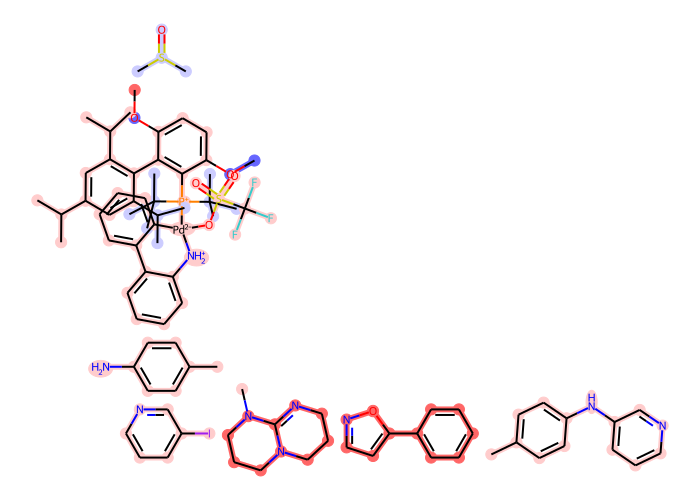

In [71]:
example_id = 0
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])
# print(tokens)
map_dict = map_atom2stridx(tokens)
mol = Chem.MolFromSmiles(tokens.replace('>>', '.')) if '>>' in tokens else Chem.MolFromSmiles(tokens.replace('>', '.'))
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)
#mol_smi = Chem.MolFromSmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = torch.sum(labels[example_id]*(shap_values[example_id].values), axis=1)
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
# print(torch.Tensor(shap_values[0].values[:, 366]))
# scaled = torch.sigmoid(torch.Tensor(shap_values[0].values[:, 366])**9)
# print(scaled)
for fg in fg_ids+fg_chids:
    shap_val = []
    for a in fg:
        shap_val.extend(shap_tokens[map_dict[a][0]:map_dict[a][1]].tolist())
    for a in fg:
        color_dicts_a[a] = bwr(cs.convert(np.max(shap_val)))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(700,500))#, label='idx')

In [59]:
color_dicts_a

{0: (1.0, 0.7999999999999998, 0.7999999999999998),
 12: (1.0, 0.7999999999999998, 0.7999999999999998),
 24: (1.0, 0.4, 0.4),
 25: (1.0, 0.4, 0.4),
 16: (1.0, 0.4, 0.4),
 20: (1.0, 0.4, 0.4),
 27: (0.4, 0.4, 1.0),
 32: (0.4, 0.4, 1.0),
 53: (1.0, 0.7999999999999998, 0.7999999999999998),
 44: (1.0, 0.7999999999999998, 0.7999999999999998),
 35: (1.0, 0.7999999999999998, 0.7999999999999998),
 45: (1.0, 0.7999999999999998, 0.7999999999999998),
 46: (1.0, 0.7999999999999998, 0.7999999999999998),
 47: (1.0, 0.7999999999999998, 0.7999999999999998),
 48: (1.0, 0.7999999999999998, 0.7999999999999998),
 50: (1.0, 0.7999999999999998, 0.7999999999999998),
 51: (1.0, 0.7999999999999998, 0.7999999999999998),
 52: (1.0, 0.7999999999999998, 0.7999999999999998),
 85: (0.8, 0.8, 1.0),
 83: (0.8, 0.8, 1.0),
 102: (1.0, 0.7999999999999998, 0.7999999999999998),
 2: (1.0, 0.7999999999999998, 0.7999999999999998),
 1: (1.0, 0.7999999999999998, 0.7999999999999998),
 6: (1.0, 0.7999999999999998, 0.79999999999999

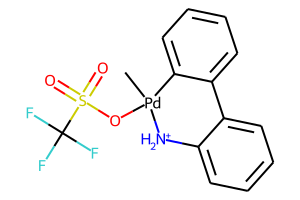

In [62]:
prettymol("C[Pd]1([NH2+]C2=CC=CC=C2C2=CC=CC=C12)OS(=O)(=O)C(F)(F)F")

In [63]:
from rdkit.Chem import rdAbbreviations

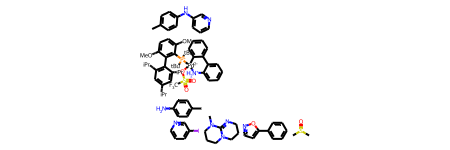

In [64]:
abbrevs = rdAbbreviations.GetDefaultAbbreviations()
nm = rdAbbreviations.CondenseMolAbbreviations(mol,abbrevs)
nm

In [143]:
atom1.GetPropsAsDict(), atom1.SetProp('_dis','No')

({'__computedProps': <rdkit.rdBase._vectSs at 0x1482905fded0>,
  'atomLabel': 'CF3',
  '_displayLabel': 'CF<sub>3</sub>',
  '_displayLabelW': 'F<sub>3</sub>C',
  '_dis': 'No'},
 None)

In [142]:
for atom1, atom2 in zip(nm.GetAtoms(), mol.GetAtoms()):
    print(atom1.GetIdx(), atom1.GetSymbol(),atom2.GetIdx(), atom2.GetSymbol())

0 * 0 I
1 Pd 1 C
2 N 2 C
3 C 3 C
4 C 4 C
5 C 5 N
6 C 6 C
7 C 7 C
8 C 8 C
9 C 9 C
10 C 10 C
11 C 11 C
12 C 12 N
13 C 13 C
14 C 14 C
15 O 15 C
16 S 16 N
17 O 17 C
18 O 18 C
19 * 19 C


In [72]:
len(nm.GetAtoms()), len(mol.GetAtoms())

(94, 111)

In [184]:
bwr(1)

(0.4, 0.4, 1.0, 1.0)

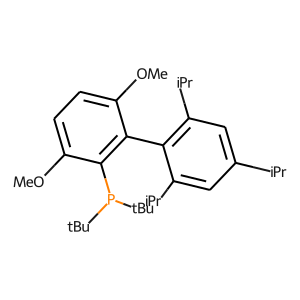

In [189]:
color_dicts_a_new = {}
color_dicts_b_new = {}
abbrevs = rdAbbreviations.GetDefaultAbbreviations()
sub_mol = Chem.MolFromSmiles("COC1=CC=C(OC)C(=C1P(C(C)(C)C)C(C)(C)C)C1=C(C=C(C=C1C(C)C)C(C)C)C(C)C")
nm = rdAbbreviations.CondenseMolAbbreviations(sub_mol,abbrevs)
for a in nm.GetAtoms():
    if a.GetIdx() == 0:
        a.SetProp('atomLabel', 'L')
        a.SetProp('_displayLabel', 'L')
    color_dicts_a_new[a.GetIdx()] = (1.0, 0.7999999999999998, 0.7999999999999998)
color_dicts_a_new.update({9:(0.8, 0.8, 1.0), 10:(0.8, 0.8, 1.0), 19:(0.8, 0.8, 1.0), 0:(0.4, 0.4, 1.0), 5:bwr(3)})
for bond in nm.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_dicts_a_new and b in color_dicts_a_new and color_dicts_a_new[a]==color_dicts_a_new[b]:
        color_dicts_b_new[bond.GetIdx()] = color_dicts_a_new[a]
prettymol(nm, asMol=True, imgsize=(300,300))#,highlights={'highlightAtoms':color_dicts_a_new.keys(), 
#                                                          'highlightAtomColors':color_dicts_a_new, 
#                                                          'highlightBonds':color_dicts_b_new.keys(),
#                                                          'highlightBondColors':color_dicts_b_new,
#                                                         })

33 (0.4, 0.4, 1.0)
32 (0.4, 0.4, 1.0)
31 (1.0, 0.7999999999999998, 0.7999999999999998)
30 (1.0, 0.7999999999999998, 0.7999999999999998)
29 (1.0, 0.7999999999999998, 0.7999999999999998)
28 (1.0, 0.7999999999999998, 0.7999999999999998)
27 (0.4, 0.4, 1.0)
26 (1.0, 0.4, 0.4)
66 (1.0, 0.7999999999999998, 0.7999999999999998)
34 (1.0, 0.7999999999999998, 0.7999999999999998)
35 (1.0, 0.7999999999999998, 0.7999999999999998)
36 (0.8, 0.8, 1.0)
37 (0.8, 0.8, 1.0)
38 (0.8, 0.8, 1.0)
39 (0.8, 0.8, 1.0)
40 (0.8, 0.8, 1.0)
41 (0.8, 0.8, 1.0)
42 (0.8, 0.8, 1.0)
43 (0.8, 0.8, 1.0)
67 (1.0, 0.7999999999999998, 0.7999999999999998)
68 (1.0, 0.7999999999999998, 0.7999999999999998)
72 (1.0, 0.7999999999999998, 0.7999999999999998)
73 (1.0, 0.7999999999999998, 0.7999999999999998)
77 (1.0, 0.7999999999999998, 0.7999999999999998)
78 (1.0, 0.7999999999999998, 0.7999999999999998)
79 (0.8, 0.8, 1.0)
80 (0.8, 0.8, 1.0)
81 (0.8, 0.8, 1.0)
74 (1.0, 0.7999999999999998, 0.7999999999999998)
75 (1.0, 0.7999999999999998, 

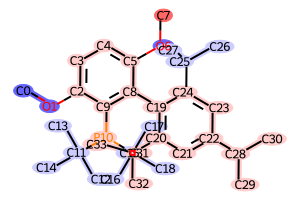

In [153]:
color_dicts_a_new = {}
color_dicts_b_new = {}
sub_mol = Chem.MolFromSmiles("COC1=CC=C(OC)C(=C1P(C(C)(C)C)C(C)(C)C)C1=C(C=C(C=C1C(C)C)C(C)C)C(C)C")
for a,b in zip(sub_mol.GetAtoms(), mol.GetSubstructMatch(sub_mol)):
    color_dicts_a_new[a.GetIdx()] = color_dicts_a[b]
    print(b,color_dicts_a[b])
for bond in sub_mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_dicts_a_new and b in color_dicts_a_new and color_dicts_a_new[a]==color_dicts_a_new[b]:
        color_dicts_b_new[bond.GetIdx()] = color_dicts_a_new[a]
prettymol(sub_mol, asMol=True, label='idx', highlights={'highlightAtoms':color_dicts_a_new.keys(), 'highlightAtomColors':color_dicts_a_new,'highlightBonds':color_dicts_b_new.keys(),'highlightBondColors':color_dicts_b_new})#, imgsize=(700,500), label='idx')

In [131]:
color_dicts_a_new

{0: (0.4, 0.4, 1.0),
 1: (0.4, 0.4, 1.0),
 2: (1.0, 0.7999999999999998, 0.7999999999999998),
 3: (1.0, 0.7999999999999998, 0.7999999999999998),
 4: (1.0, 0.7999999999999998, 0.7999999999999998),
 5: (1.0, 0.7999999999999998, 0.7999999999999998),
 6: (0.4, 0.4, 1.0),
 7: (1.0, 0.4, 0.4),
 8: (1.0, 0.7999999999999998, 0.7999999999999998),
 9: (1.0, 0.7999999999999998, 0.7999999999999998),
 10: (1.0, 0.7999999999999998, 0.7999999999999998),
 11: (0.8, 0.8, 1.0),
 12: (0.8, 0.8, 1.0),
 13: (0.8, 0.8, 1.0),
 14: (0.8, 0.8, 1.0),
 15: (0.8, 0.8, 1.0),
 16: (0.8, 0.8, 1.0),
 17: (0.8, 0.8, 1.0),
 18: (0.8, 0.8, 1.0),
 19: (1.0, 0.7999999999999998, 0.7999999999999998),
 20: (1.0, 0.7999999999999998, 0.7999999999999998),
 21: (1.0, 0.7999999999999998, 0.7999999999999998),
 22: (1.0, 0.7999999999999998, 0.7999999999999998),
 23: (1.0, 0.7999999999999998, 0.7999999999999998),
 24: (1.0, 0.7999999999999998, 0.7999999999999998),
 25: (0.8, 0.8, 1.0),
 26: (0.8, 0.8, 1.0),
 27: (0.8, 0.8, 1.0),
 28:

In [4]:
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm

In [2]:
total_table = pd.read_csv("../data/USPTO_MT/train.csv")

In [3]:
from collections import Counter

In [4]:
label_counter = Counter(total_table.labels)

In [5]:
label_counter.most_common(100)

[(0, 4145),
 (1, 3045),
 (2, 2952),
 (3, 2354),
 (4, 1971),
 (5, 1957),
 (6, 1802),
 (8, 1535),
 (7, 1530),
 (9, 1472),
 (11, 1304),
 (10, 1302),
 (12, 1034),
 (13, 1011),
 (17, 949),
 (14, 887),
 (15, 878),
 (18, 867),
 (16, 840),
 (22, 810),
 (19, 800),
 (28, 672),
 (25, 670),
 (31, 658),
 (20, 655),
 (32, 644),
 (34, 641),
 (35, 631),
 (24, 628),
 (37, 609),
 (27, 609),
 (21, 606),
 (39, 599),
 (23, 596),
 (36, 590),
 (38, 576),
 (26, 554),
 (40, 546),
 (50, 531),
 (29, 528),
 (46, 519),
 (42, 514),
 (33, 510),
 (48, 501),
 (41, 501),
 (44, 494),
 (45, 492),
 (47, 479),
 (49, 470),
 (54, 464),
 (43, 463),
 (51, 463),
 (30, 461),
 (56, 457),
 (59, 455),
 (57, 447),
 (53, 445),
 (62, 438),
 (58, 437),
 (52, 435),
 (63, 434),
 (60, 412),
 (64, 406),
 (66, 405),
 (71, 404),
 (67, 403),
 (65, 399),
 (73, 394),
 (69, 380),
 (75, 377),
 (72, 374),
 (55, 372),
 (79, 370),
 (61, 365),
 (80, 363),
 (77, 362),
 (74, 360),
 (83, 359),
 (70, 358),
 (68, 352),
 (85, 351),
 (84, 351),
 (81, 347),


In [3]:
total_table.head()

,level_0,index,original_rxn,fragments,source,year,mapped_rxn,confidence,canonical_rxn_with_fragment_info,canonical_rxn,...,reaction_hash,reactants,products,retro_template,template_hash,selectivity,outcomes,reagents,labels,Yield
0,347973,593430.0,[F:1][C:2]([F:17])([F:16])[C:3]1[CH:4]=[C:5]([...,NaN,US06521621B1_,2003,CCN(CC)CC.ClCCl.Cl[C:21](=[O:22])[c:23]1[cH:24...,0.047697,CCN(CC)CC.Cc1cccc(C)c1NC(=O)CN1CCN([C@@H]2CCN[...,Cc1cccc(C)c1NC(=O)CN1CCN([C@@H]2CCN[C@@H](Cc3c...,...,37f26402974cfa30cbb918c72ff79da49ad4c73ff0f4fd...,Cc1cccc(C)c1NC(=O)CN1CCN([C@@H]2CCN[C@@H](Cc3c...,Cc1cccc(C)c1NC(=O)CN1CCN([C@@H]2CCN(C(=O)c3cc(...,([C:4]-[N;H0;D3;+0:5](-[C:6])-[C;H0;D3;+0:1](=...,8e776da45ba18fd7625e94abe947f9adcda1a9454a884e...,1.0,1.0,CCN(CC)CC.ClCCl,68,44.0
1,959339,1613617.0,[CH3:1][O:2][C:3]1[CH:4]=[C:5]2[C:9](=[CH:10][...,NaN,US09024027B2_0419,2015,CC(C)(C)[O:17][C:15]([CH2:14][N:13]1[c:6]2[cH:...,0.963933,COc1ccc2c(c1)C(=O)C(=O)N2CC(=O)OC(C)(C)C.ClCCl...,COc1ccc2c(c1)C(=O)C(=O)N2CC(=O)OC(C)(C)C>ClCCl...,...,8b8302678c5984d2fd350539a2f2e5a60be94bc71ec476...,COc1ccc2c(c1)C(=O)C(=O)N2CC(=O)OC(C)(C)C,COc1ccc2c(c1)C(=O)C(=O)N2CC(=O)O,([C:3]-[C:2](=[O;D1;H0:4])-[OH;D1;+0:1])>>(C-C...,cd4c8dfb74ae00d4ec8387e8837370d2f9fd4ad5e54ff5...,1.0,1.0,ClCCl.O=C(O)C(F)(F)F,18,91.0
2,408415,697422.0,[NH2:1][CH2:2][CH2:3][CH:4]1[CH2:8][CH2:7][CH2...,|f:3.4|,US06949553B2_0122,2005,CO[C:18]([CH2:17][CH2:16][CH2:15][CH2:14][CH2:...,0.800727,CCCCCCCC/C=C\CCCCCCCC(=O)OC.CN1CCCC1CCN.Cc1ccc...,CCCCCCCC/C=C\CCCCCCCC(=O)OC.CN1CCCC1CCN>Cc1ccc...,...,aee1733b85eaa5b4738c0f92e100d23af94f282eb6a925...,CCCCCCCC/C=C\CCCCCCCC(=O)OC.CN1CCCC1CCN,CCCCCCCC/C=C\CCCCCCCC(=O)NCCC1CCCN1C,([C:2]-[C;H0;D3;+0:1](=[O;D1;H0:3])-[NH;D2;+0:...,a09aa8aa029f726b6925197c5975f0ab8b7625aa671779...,1.0,1.0,Cc1ccccc1.Cl.[Na+].[OH-],382,62.1
3,485527,817717.0,[NH2:1][C:2]1[CH:7]=[C:6]([C:8]2[CH:13]=[CH:12...,|f:2.3|,US07314849B2_0274,2008,O=S(=O)(O)O.[CH3:1][O:2][C:3](=[O:4])[c:5]1[n:...,0.342196,COC(=O)c1nc(-c2ccc(Cl)cc2F)cc(N)c1Cl.O=S(=O)(O...,COC(=O)c1nc(-c2ccc(Cl)cc2F)cc(N)c1Cl.O=[N+]([O...,...,cabf9c9a8da2a605b9fd5458873c3bb8730c482dbd0975...,COC(=O)c1nc(-c2ccc(Cl)cc2F)cc(N)c1Cl.O=[N+]([O...,COC(=O)c1nc(-c2cc([N+](=O)[O-])c(Cl)cc2F)cc(N)...,([O;-;D1;H0:2]-[N+;H0;D3:1](=[O;D1;H0:3])-[c;H...,2a3e7ecb49fb48293467a22967b3d24f152b96f92032ae...,1.0,1.0,O=S(=O)(O)O.[Na+],268,84.4
4,400061,683608.0,I[C:2]1[CH:8]=[CH:7][CH:6]=[CH:5][C:3]=1[NH2:4...,"|f:3.4,6.7.8.9|",US06894061B2_0807,2005,C1CCOC1.ClCCl.Cl[Pd]Cl.I[c:6]1[cH:7][cH:8][cH:...,0.865322,C1CCOC1.Cc1ccc(B(O)O)cc1.ClCCl.Cl[Pd]Cl~[Fe+2]...,Cc1ccc(B(O)O)cc1.Nc1ccccc1I>C1CCOC1.ClCCl.Cl[P...,...,21ca38a840f6410aa4bf37464edddcd23d638f3ad39d3f...,Cc1ccc(B(O)O)cc1.Nc1ccccc1I,Cc1ccc(-c2ccccc2N)cc1,([c:2]:[c;H0;D3;+0:1](:[c:3])-[c;H0;D3;+0:4](:...,7dd39e88343158d749428576676d52834a98797b3952df...,0.5,2.0,C1CCOC1.ClCCl.Cl[Pd]Cl.[Fe+2].[Na+].[OH-].c1cc...,249,78.0


In [48]:
from tqdm import tqdm

In [211]:
reactants, reagents, product, rxn = [],[],[],[]
for line in tqdm(total_table.itertuples(), total=len(total_table)):
    rcts, rgts, prod = line.original_rxn.split('>')
    real_rgts = [standize(x) for x in line.reagents.split('.')]
    rcts = rcts+'.'+rgts if rgts else rcts
    rcts = [standize(x) for x in rcts.split('.')]
    total = len(rcts)
    rcts = list_minus(rcts, real_rgts.copy())
    assert len(rcts)+len(real_rgts)==total
    rcts = standize('.'.join(rcts))
    rgts = standize('.'.join(real_rgts))
    prod = standize(prod)
    reactants.append(rcts)
    reagents.append(rgts)
    product.append(prod)
    rxn.append(rcts+'>'+rgts+'>'+prod)
#     break

100%|██████████| 116360/116360 [08:04<00:00, 240.37it/s]


In [200]:
# map_dict = {x:i for i,x in enumerate(top_500)}
# map_dict

{1: 0,
 7: 1,
 88: 2,
 247: 3,
 575: 4,
 171: 5,
 48: 6,
 334: 7,
 146: 8,
 152: 9,
 230: 10,
 75: 11,
 44: 12,
 0: 13,
 138: 14,
 17: 15,
 73: 16,
 269: 17,
 278: 18,
 193: 19,
 365: 20,
 50: 21,
 23: 22,
 837: 23,
 9: 24,
 142: 25,
 808: 26,
 127: 27,
 708: 28,
 220: 29,
 674: 30,
 538: 31,
 694: 32,
 11: 33,
 197: 34,
 5: 35,
 33: 36,
 112: 37,
 567: 38,
 225: 39,
 484: 40,
 468: 41,
 125: 42,
 43: 43,
 74: 44,
 478: 45,
 356: 46,
 631: 47,
 202: 48,
 140: 49,
 84: 50,
 942: 51,
 26: 52,
 99: 53,
 179: 54,
 294: 55,
 217: 56,
 24: 57,
 485: 58,
 979: 59,
 21: 60,
 68: 61,
 231: 62,
 89: 63,
 29: 64,
 45: 65,
 91: 66,
 58: 67,
 201: 68,
 564: 69,
 36: 70,
 242: 71,
 433: 72,
 195: 73,
 444: 74,
 246: 75,
 194: 76,
 4: 77,
 271: 78,
 62: 79,
 337: 80,
 98: 81,
 248: 82,
 343: 83,
 133: 84,
 122: 85,
 584: 86,
 87: 87,
 731: 88,
 126: 89,
 440: 90,
 599: 91,
 70: 92,
 251: 93,
 676: 94,
 162: 95,
 960: 96,
 72: 97,
 49: 98,
 212: 99,
 31: 100,
 313: 101,
 473: 102,
 187: 103,
 493: 104

In [212]:
assert sum([x for x in reactants if not x])==0
assert sum([x for x in reagents if not x])==0
assert sum([x for x in product if not x])==0
assert sum([x for x in rxn if not x])==0
total_table['reactants'] = reactants
total_table['reagents'] = reagents
total_table['products'] = product
total_table['canonical_rxn'] = rxn
del total_table['Unnamed: 0']
del total_table['Unnamed: 0.1']
total_table['labels'] = total_table['labels'].apply(lambda x: map_dict[x])
total_table.to_csv("../data/USPTO_MT/train.csv", index=False)

In [205]:
map_dict[62]

79

In [123]:
def list_minus(list1, list2):
    return [i for i in list1 if not i in list2 or list2.remove(i)]

In [86]:
all_yield=[]
for i,rxn in enumerate(tqdm(total_table["original_rxn"])):
    rcts, rgts, prod = rxn.split('>')
    part1 = standize(rcts+'.'+rgts) if rgts else standize(rcts)
    part2 = standize(prod)
    all_yield.append(rxn_yield.get((part1, part2), None))
#     print(part1, part2, all_yield)

100%|██████████| 44511/44511 [01:01<00:00, 725.47it/s]


In [72]:
top_500 = [int(x) for x in top_500]

In [75]:
isin = lambda x:x in top_500

In [90]:
total_table[total_table['labels'].apply(isin)].to_csv("../data/USPTO_1k_TPL/Yield/test.csv", index=False)

In [56]:
import numpy as np

In [88]:
total_table['Yield'] = all_yield
total_table[pd.notna(total_table['Yield'])].to_csv("../data/USPTO_1k_TPL/Yield/test.csv")

In [30]:
from EFGs import standize

In [37]:
# rxn_yield = {}
with open("../data/USPTO_yield/train_yield.txt") as rf:
    for line in rf:
        rxn, _yield = line.strip().split()
        rcts, rgts, prod = rxn.split('>')
        part1 = standize(rcts+'.'+rgts) if rgts else standize(rcts)
        part2 = standize(prod)
        rxn_yield[(part1, part2)]=float(_yield)*100

In [5]:
rxns = total_table['canonical_rxn']

In [10]:
from rdkit import Chem
import random

In [11]:
def gen_randomSmiles(smi):                                                      
    return Chem.MolToSmiles(Chem.MolFromSmiles(smi), doRandom=True)             
                                                                                
def get_random(smi):                                                            
    try:                                                                        
        mols = smi.split('.')                                                   
        random.shuffle(mols)                                                    
        return '.'.join([gen_randomSmiles(x) for x in mols])                    
    except:                                                                     
        return ''

In [12]:
from rdkit import RDLogger
lg = RDLogger.logger()
lg.setLevel(RDLogger.ERROR)

In [18]:
# Chem.MolFromSmiles('')

RDKit ERROR: [18:51:25] SMILES Parse Error: unclosed ring for input: 'c1c'


In [19]:
from data.data_utils import MolTokenizer
tokenizer = MolTokenizer()
all_rxns = {}
for i, rxn in enumerate(tqdm(rxns, desc='X5')):
    all_rxns[i] = []
    rct, rgs, prod = rxn.split('>')                                        
    random_rxns = {rxn}                                                    
    for _ in range(4):                                         
        rct = get_random(rct)                                              
        rgs = get_random(rgs)                                              
        prod = get_random(prod)                                            
        random_rxns.add('>'.join([rct, rgs, prod]))                                                                 
    for rxn in random_rxns:                                                
        try:                                                               
            _ = tokenizer.tokenize(rxn)                                    
            all_rxns[i].append(rxn) 
        except:                                                            
            continue

X5: 100%|█████████▉| 116345/116360 [05:10<00:00, 382.38it/s]

KeyboardInterrupt: 

In [47]:
format(44, '#09b')

'0b0101100'

In [50]:
target = open("../data/USPTO_MT_X5/binary/val.target", "w")
with open("../data/USPTO_MT_X5/Yield/val.target") as rf:
    for line in rf:
        num = round(float(line.strip()))
        print(format(num, '#09b')[2:], file=target)

In [51]:
target.close()

In [81]:
phase = "test"
n = 10
topk = f"top{n}"
total_table = pd.read_csv(f"../data/USPTO_MT/{phase}.csv")
topn_class = [x[0] for x in label_counter.most_common(n)]
total_table = total_table[total_table['labels'].isin(topn_class)]
rxn = total_table['canonical_rxn']

In [24]:
# source = open(f"../data/USPTO_MT/{topk}/Product/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Product/{phase}.target", 'w')
# for x in rxn:
source = open(f"../data/USPTO_MT_X5/Product/train.source", 'w')
target = open(f"../data/USPTO_MT_X5/Product/train.target", 'w')
for i in range(len(all_rxns)):
    for x in all_rxns[i]:
        a,b,c = x.split('>')
        print(a+'.'+b+'>>', file=source)
        print(c, file=target)
source.close()
target.close()

In [25]:
# source = open(f"../data/USPTO_MT/{topk}/Reactants/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Reactants/{phase}.target", 'w')
# for x in rxn:
source = open(f"../data/USPTO_MT_X5/Reactants/train.source", 'w')
target = open(f"../data/USPTO_MT_X5/Reactants/train.target", 'w')
for i in range(len(all_rxns)):
    for x in all_rxns[i]:
        a,b,c = x.split('>')
        print(c, file=source)
        print(a, file=target)
source.close()
target.close()

In [26]:
# source = open(f"../data/USPTO_MT/{topk}/Reagents/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Reagents/{phase}.target", 'w')
# for x in rxn:
source = open(f"../data/USPTO_MT_X5/Reagents/train.source", 'w')
target = open(f"../data/USPTO_MT_X5/Reagents/train.target", 'w')
for i in range(len(all_rxns)):
    for x in all_rxns[i]:
        a,b,c = x.split('>')
        print(a+'>>'+c, file=source)
        print(b, file=target)
source.close()
target.close()

In [78]:
# source = open(f"../data/USPTO_MT/{topk}/Retrosynthesis/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Retrosynthesis/{phase}.target", 'w')
# for x in rxn:
#     a,b,c = x.split('>')
#     print(c, file=source)
#     print(a+'.'+b, file=target)
# source.close()
# target.close()

In [29]:
for line in total_table.itertuples():
    pass

In [30]:
line.Index

116359

In [31]:
# source = open(f"../data/USPTO_MT/{topk}/Yield/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Yield/{phase}.target", 'w')
# for line in total_table.itertuples():
source = open(f"../data/USPTO_MT_X5/Yield/train.source", 'w')
target = open(f"../data/USPTO_MT_X5/Yield/train.target", 'w')
for line in total_table.itertuples():
    for x in all_rxns[line.Index]:
        print(x, file=source)
        print("{:.2f}".format(line.Yield), file=target)
source.close()
target.close()

In [32]:
# source = open(f"../data/USPTO_MT/{topk}/Classification/{phase}.source", 'w')
# target = open(f"../data/USPTO_MT/{topk}/Classification/{phase}.target", 'w')
# for line in total_table.itertuples():
source = open(f"../data/USPTO_MT_X5/Classification/train.source", 'w')
target = open(f"../data/USPTO_MT_X5/Classification/train.target", 'w')
for line in total_table.itertuples():
    for x in all_rxns[line.Index]:
        print(x, file=source)
        print(line.labels, file=target)
source.close()
target.close()

In [18]:
top100 = [x[0] for x in label_counter.most_common(100)]
top50 = [x[0] for x in label_counter.most_common(50)]
top10 = [x[0] for x in label_counter.most_common(10)]
top100rxns = total_table[total_table['labels'].isin(top100)]
top50rxns = total_table[total_table['labels'].isin(top50)]
top10rxns = total_table[total_table['labels'].isin(top10)]

Text(0, 0.5, 'Frequency')

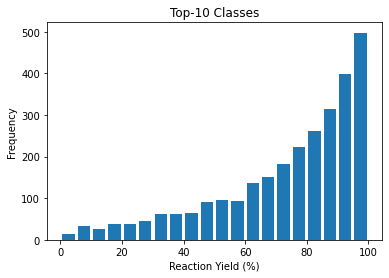

In [23]:
plt.hist(top10rxns.Yield, bins=20, rwidth=0.8)
plt.title("Top-10 Classes")
plt.xlabel("Reaction Yield (%)")
plt.ylabel("Frequency")

In [22]:
len(top100rxns), len(top50rxns), len(top10rxns)

(8404, 6111, 2826)

In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
%matplotlib notebook

In [2]:
all_data = pd.read_csv("../USPTO_500_MT.csv")

In [3]:
all_data

,Top-k,prod_mix_acc,prod_mix_inv,react_mix_acc,react_mix_inv,reag_mix_acc,reag_mix_inv,prod_sep_acc,prod_sep_inv,react_sep_acc,react_sep_inv,reag_sep_acc,reag_sep_inv
0,Top-1,97.0,0.11,72.2,0.04,22.5,0.01,97.7,0.23,74.0,0.22,24.9,0.04
1,Top-2,98.7,2.34,86.0,0.23,30.6,0.15,98.8,48.30,85.4,8.98,31.8,0.47
2,Top-3,99.2,4.33,91.6,0.41,35.3,0.15,99.1,51.59,89.4,15.82,36.0,0.52
3,Top-4,99.4,5.53,94.0,0.72,38.6,0.09,99.2,53.87,91.4,20.62,38.3,0.61
4,Top-5,99.5,6.74,95.4,0.66,41.0,0.18,99.2,54.49,92.5,25.24,40.2,1.09


In [14]:
inv_cols = [x for x in all_data.columns if x.endswith('_inv')]
for col in inv_cols:
    array = all_data[col]
    num_invalid = 0
    true = []
    for i in range(len(array)):
        num_invalid += round(14238*array[i]/100)
        total_preds = 14238*(i+1)
        true.append(round(num_invalid/total_preds*100,2))
    all_data[col] = true

In [15]:
all_data

,Top-k,prod_mix_acc,prod_mix_inv,react_mix_acc,react_mix_inv,reag_mix_acc,reag_mix_inv,prod_sep_acc,prod_sep_inv,react_sep_acc,react_sep_inv,reag_sep_acc,reag_sep_inv
0,Top-1,97.0,0.11,72.2,0.04,22.5,0.01,97.7,0.23,74.0,0.22,24.9,0.04
1,Top-2,98.7,1.23,86.0,0.14,30.6,0.08,98.8,24.27,85.4,4.60,31.8,0.26
2,Top-3,99.2,2.26,91.6,0.23,35.3,0.10,99.1,33.37,89.4,8.34,36.0,0.34
3,Top-4,99.4,3.08,94.0,0.35,38.6,0.10,99.2,38.50,91.4,11.41,38.3,0.41
4,Top-5,99.5,3.81,95.4,0.41,41.0,0.12,99.2,41.70,92.5,14.18,40.2,0.55


<IPython.core.display.Javascript object>


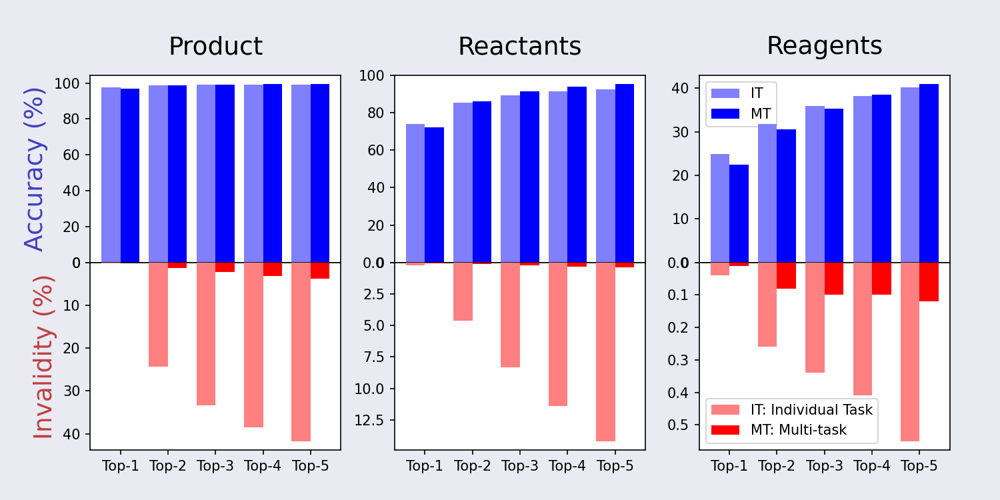

In [22]:
font_color = '#525252'
hfont = {'fontname':'Calibri'}
facecolor = '#eaeaf2'
color_inv_sep = '#FF8080'
color_inv_mix = '#FF0000'
color_acc_sep = '#8080FF'
color_acc_mix = '#0000FF'
index = all_data.index
width = 0.4  # the width of the bars

fig, axes = plt.subplots(figsize=(10,5), facecolor=facecolor, nrows=2, ncols=3, sharex=True)
fig.tight_layout()

axes[0][0].bar(index+width/2, all_data['prod_mix_acc'], width=width, align='center', color=color_acc_mix, zorder=10)
axes[0][0].bar(index-width/2, all_data['prod_sep_acc'], width=width, align='center', color=color_acc_sep, zorder=10)
axes[0][0].set_ylabel('Accuracy (%)', fontsize=18, color='#4040BF', **hfont)
axes[0][0].set_title('Product', fontsize=18, pad=15, **hfont)

axes[1][0].bar(index+width/2, all_data['prod_mix_inv'],width=width, align='center', color=color_inv_mix, zorder=10)
axes[1][0].bar(index-width/2, all_data['prod_sep_inv'],width=width, align='center', color=color_inv_sep, zorder=10)
axes[1][0].set_ylabel('Invalidity (%)', fontsize=18, color='#BF4040', **hfont)
# axes[1][0].set_title(title0, fontsize=18, pad=15, color=color_red, **hfont)
# plt.gca().invert_yaxis()
axes[1][0].invert_yaxis()


axes[0][1].bar(index+width/2, all_data['react_mix_acc'], width=width, align='center', color=color_acc_mix, zorder=10)
axes[0][1].bar(index-width/2, all_data['react_sep_acc'], width=width, align='center', color=color_acc_sep, zorder=10)
axes[0][1].set_title('Reactants', fontsize=18, pad=15, **hfont)

axes[1][1].bar(index+width/2, all_data['react_mix_inv'],width=width, align='center', color=color_inv_mix, zorder=10)
axes[1][1].bar(index-width/2, all_data['react_sep_inv'],width=width, align='center', color=color_inv_sep, zorder=10)
# axes[1][0].set_title(title0, fontsize=18, pad=15, color=color_red, **hfont)
# plt.gca().invert_yaxis()
axes[1][1].invert_yaxis()



axes[0][2].bar(index-width/2, all_data['reag_sep_acc'], width=width, align='center', color=color_acc_sep, zorder=10, label='IT')
axes[0][2].bar(index+width/2, all_data['reag_mix_acc'], width=width, align='center', color=color_acc_mix, zorder=10, label='MT')
axes[0][2].set_title('Reagents', fontsize=18, pad=15, **hfont)
axes[0][2].legend()
axes[1][2].bar(index-width/2, all_data['reag_sep_inv'],width=width, align='center', color=color_inv_sep, zorder=10, label='IT: Individual Task')
axes[1][2].bar(index+width/2, all_data['reag_mix_inv'],width=width, align='center', color=color_inv_mix, zorder=10, label='MT: Multi-task')
# axes[1][0].set_title(title0, fontsize=18, pad=15, color=color_red, **hfont)
# plt.gca().invert_yaxis()
axes[1][2].invert_yaxis()
axes[1][2].legend()


# axes[0].set(yticks=all_data.index, yticklabels=all_data.index)
# axes[0][0].yaxis.tick_left()
# axes[0].tick_params(axis='y', colors='white')

axes[1][0].set_xticks([0,1,2,3,4])
axes[1][0].set_xticklabels(['Top-1', 'Top-2', 'Top-3', 'Top-4', 'Top-5'])

# for label in (axes[0][0].get_xticklabels() + axes[0][0].get_yticklabels()):
#     label.set(fontsize=13, color=font_color, **hfont)
# for label in (axes[1][0].get_xticklabels() + axes[1][0].get_yticklabels()):
#     label.set(fontsize=13, color=font_color, **hfont)

plt.subplots_adjust(hspace=0, top=0.85, bottom=0.1, left=0.09, right=0.95)
plt.savefig('USPTO_500_MT.png', facecolor=facecolor)

In [13]:
from data.data_utils import MolTokenizer
tokenizer = MolTokenizer()
rxn = "CC1(C)CCCCC(C)(C)C1=O>CCOCC.O.O=S(=O)(O)O.[Al+3].[H-].[H-].[H-].[H-].[Li+]>CC1(C)CCCCC(C)(C)C1O"
rct, rgs, prod = rxn.split('>')                                        
random_rxns = {rxn}                                                    
for _ in range(4):                                         
    rct = get_random(rct)                                              
    rgs = get_random(rgs)                                              
    prod = get_random(prod)                                            
    random_rxns.add('>'.join([rct, rgs, prod]))                                                                 
for rxn in random_rxns:                                                
    try:                                                               
        _ = tokenizer.tokenize(rxn)                                    
        print(rxn)
    except:                                                            
        continue

C1C(C)(C)C(=O)C(C)(CCC1)C>CCOCC.O.[H-].[H-].[H-].[Al+3].O=S(=O)(O)O.[H-].[Li+]>C1CCCC(C(C1(C)C)O)(C)C
CC1(C(=O)C(CCCC1)(C)C)C>O=S(O)(O)=O.[H-].[H-].O.C(OCC)C.[H-].[Li+].[H-].[Al+3]>CC1(C)C(C(CCCC1)(C)C)O
C1C(C)(C(=O)C(C)(CCC1)C)C>[Li+].[Al+3].O.OS(=O)(=O)O.[H-].[H-].[H-].CCOCC.[H-]>CC1(C)C(O)C(C)(C)CCCC1
CC1(C)CCCCC(C)(C)C1=O>CCOCC.O.O=S(=O)(O)O.[Al+3].[H-].[H-].[H-].[H-].[Li+]>CC1(C)CCCCC(C)(C)C1O
CC1(CCCCC(C)(C)C1=O)C>O=S(=O)(O)O.[H-].[H-].[H-].C(C)OCC.O.[H-].[Al+3].[Li+]>CC1(C(C(C)(C)CCCC1)O)C
